In [1]:
# !pip install torch torchvision
# !pip install transformers
# !pip install datasets
# !pip install diffusers accelerate safetensors

In [1]:
import PIL
import requests
import torch
from diffusers import StableDiffusionInstructPix2PixPipeline, EulerAncestralDiscreteScheduler,StableDiffusionPix2PixZeroPipeline

# model_id = "timbrooks/instruct-pix2pix"
model_id = 'skinTreat'
pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float16, safety_checker=None)
pipe.to("cuda")

pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(pipe.scheduler.config)
pipe.config


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]


===================================BUG REPORT===================================
Welcome to bitsandbytes. For bug reports, please run

python -m bitsandbytes

 and submit this information together with your error trace to: https://github.com/TimDettmers/bitsandbytes/issues
bin c:\Users\kihoon\AppData\Local\Programs\Python\Python310\lib\site-packages\bitsandbytes\libbitsandbytes_cuda118.dll
CUDA SETUP: CUDA runtime path found: C:\Program Files\NVIDIA GPU Computing Toolkit\CUDA\v11.8\bin\cudart64_110.dll
CUDA SETUP: Highest compute capability among GPUs detected: 8.9
CUDA SETUP: Detected CUDA version 118
CUDA SETUP: Loading binary c:\Users\kihoon\AppData\Local\Programs\Python\Python310\lib\site-packages\bitsandbytes\libbitsandbytes_cuda118.dll...


FrozenDict([('vae', ('diffusers', 'AutoencoderKL')),
            ('text_encoder', ('transformers', 'CLIPTextModel')),
            ('tokenizer', ('transformers', 'CLIPTokenizer')),
            ('unet', ('diffusers', 'UNet2DConditionModel')),
            ('scheduler', ('diffusers', 'EulerAncestralDiscreteScheduler')),
            ('safety_checker', (None, None)),
            ('feature_extractor', ('transformers', 'CLIPImageProcessor')),
            ('requires_safety_checker', False),
            ('_name_or_path', 'skinTreat')])

  0%|          | 0/20 [00:00<?, ?it/s]

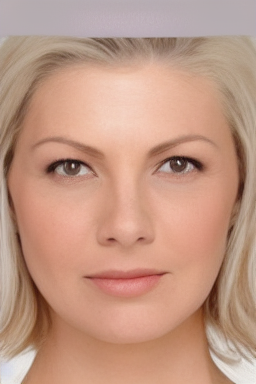

In [8]:
url = "C:/Users/kihoon/Desktop/AI/skin_care/data_last/botox_with_bunny_line/after/image_84.jpg"

def download_image(url):
    image = PIL.Image.open(url)
    image = PIL.ImageOps.exif_transpose(image)
    image = image.convert("RGB")
    return image
image = download_image(url)
image
prompt = f"Transform the image to show a subtle and clearly and natural improvement as having undergone a Reducing wrinkles on the nose, focusing on enhanced skin clarity and even tone, while preserving the original facial structure and features and output is ultra high res"
# prompt = "Reduces wrinkles on the nose when smiling."

mask  = './Face Landmark/image19.png'
import cv2
mask = cv2.imread(mask,cv2.COLOR_BGR2GRAY)
images = pipe(prompt, image=image,num_inference_steps=20, image_guidance_scale=0.2,guidance_scale=10).images
images[0]

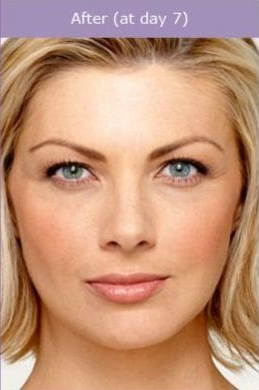

In [9]:
image


In [5]:
from datasets import load_dataset
import torch
from diffusers import StableDiffusionInstructPix2PixPipeline, EulerAncestralDiscreteScheduler
from torchvision import transforms
import numpy as np
from PIL import Image

transform = transforms.Compose([
    transforms.Resize(size=(512,512)), 
    transforms.ToTensor(),
])

# Load and preprocess the dataset
from datasets import load_dataset  # selecting a subset
datafiles= {'train':'instructpix2pix_train.csv','test':'instructpix2pix_test.csv'}
# dataset = load_dataset('csv',data_files='../dataset/instructpix2pix.csv',split='train').select(range(300))
dataset = load_dataset('csv',data_files=datafiles)
dataset

DatasetDict({
    train: Dataset({
        features: ['instruction', 'input_image', 'output_image'],
        num_rows: 1288
    })
    test: Dataset({
        features: ['instruction', 'input_image', 'output_image'],
        num_rows: 535
    })
})

In [6]:
! pip install git+https://github.com/huggingface/diffusers

Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/huggingface/diffusers to /tmp/pip-req-build-_z32qq8w
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/diffusers /tmp/pip-req-build-_z32qq8w
  Resolved https://github.com/huggingface/diffusers to commit 0eeee618cffa8c648f4a753ace243100f465ce8d
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [7]:
from datasets import Image
instruction ={
    'face_filler_with_temples':"Fills in hollow temples, balancing facial contours.",
    'botox_with_perioral_line':"Diminishes fine lines around the mouth.",
    "face_filler_with_cheek":"Adds volume to cheeks for a lifted, fuller look.",
    'face_vascular_laser':"Reduces redness and visibility of vascular lesions on the skin's surface.",
    'face_genesis_laser':"Smoothens skin texture, reduces pore size, and softens mild wrinkles.",
    'face_filler_with_nasolabial_folds':"Softens deep lines from the nose to the mouth.",
    'botox_with_bunny_line':"Reduces wrinkles on the nose",
     'botox_with_jaw':"Slims and contours the jawline for a more refined appearance.",
     "radiofrequency":"Tightens skin, improves contour, and reduces fine lines for a rejuvenated appearance."
     ,'face_filler_with_marionette_lines':" Reduces the appearance of lines from mouth corners to the chin.",
     'face_fractional_laser':"Improves skin texture, diminishes fine lines, wrinkles, and acne scars.",
     'botox_with_forehead':"Reduces horizontal forehead lines for a smoother forehead.",
     'botox_with_dimpled_chin':" Smoothens the orange peel-like texture of the chin.",
     'face_filler_with_tear_troughs':"Reduces under-eye hollows for a refreshed look.",
     "botox_with_glabellar":"Softens frown lines between the eyebrows.",
     'face_thread_lifting':"Provides an immediate lifting effect, reducing sagging and enhancing the youthfulness of the face.",
     'face_filler_with_chin':"Enhances the chin profile for a stronger appearance.",
     'face_laser_toning':"Enhances skin tone uniformity and reduces pigmentation issues like melasma and sun spots.",
     'botox_with_crow_feet':" Smoothens wrinkles around the eyes.",
     'face_filler_with_lips':"Adds volume for fuller, more defined lips.",
     'face_filler_with_nose':"Corrects minor bumps or irregularities for a smoother nose contour.",
     'radiofrequency_microneedling':"Enhances skin texture, tightens skin, and reduces the appearance of scars and large pores.",
     'high_intensity_focused_ultrasound':"Lifts and tightens skin, especially around the jawline and cheeks for a more youthful look."
}

def preprocess(data):
    image = data['input_image']
    image = transform(image)
    image2 = data['output_image']
    # Converts PIL Image to PyTorch Tensor
    image2 = transform(image2)
    instruction =  str(data['instruction'][:-1])
    prompt = f"Transform the image to show a subtle and natural improvement as if face style have chante to enhanced {instruction} while preserving the original facial structure "
    # and enhanced skin clarity and even tone"
    # while preserving the original facial structure and features."
    return {'image': image, 'instruction': prompt,'image2':image2}
train_ds = dataset['train']
train_ds = train_ds.cast_column('input_image',Image(decode=True))
valid_ds = dataset['test']
valid_ds = valid_ds.cast_column('input_image',Image(decode=True))


In [8]:
# ! pip install -U -r diffusers/examples/dreambooth/requirements.txt

In [9]:
train_ds = train_ds.cast_column('output_image',Image(decode=True))
valid_ds = valid_ds.cast_column('output_image',Image(decode=True))

In [10]:
train_ds = train_ds.map(preprocess,remove_columns=['input_image','output_image'])


Map:   0%|          | 0/1288 [00:00<?, ? examples/s]

In [11]:
valid_ds = valid_ds.map(preprocess,remove_columns=['input_image','output_image'])

Map:   0%|          | 0/535 [00:00<?, ? examples/s]

In [12]:
train_ds[0]['image']

[[[0.5568627715110779,
   0.5568627715110779,
   0.5568627715110779,
   0.5607843399047852,
   0.5686274766921997,
   0.5803921818733215,
   0.5882353186607361,
   0.5960784554481506,
   0.5960784554481506,
   0.5960784554481506,
   0.5960784554481506,
   0.5960784554481506,
   0.6078431606292725,
   0.6313725709915161,
   0.6549019813537598,
   0.6784313917160034,
   0.6941176652908325,
   0.7019608020782471,
   0.7098039388656616,
   0.7254902124404907,
   0.7411764860153198,
   0.7490196228027344,
   0.7607843279838562,
   0.7607843279838562,
   0.7568627595901489,
   0.7647058963775635,
   0.772549033164978,
   0.7843137383460999,
   0.800000011920929,
   0.8117647171020508,
   0.8235294222831726,
   0.8313725590705872,
   0.8313725590705872,
   0.8313725590705872,
   0.843137264251709,
   0.8549019694328308,
   0.8588235378265381,
   0.8627451062202454,
   0.8627451062202454,
   0.8666666746139526,
   0.8666666746139526,
   0.8666666746139526,
   0.8627451062202454,
   0.858823537

In [13]:
train_ds.set_format(type='torch', columns=['image', 'instruction','image2'])
valid_ds.set_format(type='torch', columns=['image', 'instruction','image2'])

# Load the model
# model_id = "skin_treat_best"
pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float16, safety_checker=None)
pipe.to("cuda")
pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(pipe.scheduler.config)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [ ]:
model_unet = pipe.unet
optimizer = torch.optim.Adam(model_unet.parameters(), lr=5e-6)

In [ ]:
from torchvision.transforms.functional import to_tensor

def loss_function(output, target):
    output_tensor = to_tensor(output).to(target.device).requires_grad_()
    return ((output_tensor - target) ** 2).mean()

In [ ]:
train_ds[0]['image']

tensor([[[0.5569, 0.5569, 0.5569,  ..., 0.9333, 0.8392, 0.8000],
         [0.5569, 0.5569, 0.5569,  ..., 0.9333, 0.8392, 0.8000],
         [0.5569, 0.5569, 0.5569,  ..., 0.9333, 0.8392, 0.8000],
         ...,
         [0.1922, 0.1882, 0.1725,  ..., 0.8980, 0.7725, 0.7216],
         [0.1961, 0.1922, 0.1765,  ..., 0.9020, 0.7765, 0.7255],
         [0.1961, 0.1922, 0.1765,  ..., 0.9020, 0.7765, 0.7255]],

        [[0.3608, 0.3608, 0.3608,  ..., 0.8824, 0.7725, 0.7255],
         [0.3608, 0.3608, 0.3608,  ..., 0.8824, 0.7725, 0.7255],
         [0.3608, 0.3608, 0.3608,  ..., 0.8824, 0.7725, 0.7255],
         ...,
         [0.4588, 0.4510, 0.4314,  ..., 0.9059, 0.7882, 0.7373],
         [0.4627, 0.4549, 0.4353,  ..., 0.9059, 0.7882, 0.7412],
         [0.4627, 0.4549, 0.4353,  ..., 0.9059, 0.7882, 0.7412]],

        [[0.3255, 0.3255, 0.3216,  ..., 0.8588, 0.7490, 0.7020],
         [0.3255, 0.3255, 0.3216,  ..., 0.8588, 0.7490, 0.7020],
         [0.3255, 0.3255, 0.3255,  ..., 0.8588, 0.7490, 0.

In [ ]:
# Move the model to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# pipe = pipe.to(device)

In [ ]:
import wandb
wandb.init('gan-face-before-after',reinit=True)
wandb.watch(pipe.unet)

[]

In [ ]:
validation_loss = None

In [ ]:
# Training loop
gradient_loop = 4
i=0
resolution = 512
for epoch in range(30):  # for 3 epochs
    for data in train_ds:
        optimizer.zero_grad()
        # Move data to the device
        input_image = data['image'].to(device)
        instruction = data['instruction']
        gt_image = data['image2']
        gt_image = wandb.Image(gt_image,caption='ground_truth')
        output_image = data['image2'].to(device)
        # Forward pass
        in_images=  wandb.Image(input_image,caption='input image')
        outputs = pipe(instruction, image=input_image, num_inference_steps=40, image_guidance_scale=0.2,height=resolution,width=resolution,guidance_scale=5.0)
        out_images = wandb.Image(outputs.images[-1],caption='output image')
        
        output_image_train = [in_images,out_images,gt_image]
        # Compute loss
        loss = loss_function(outputs.images[-1], output_image)  # Now both are tensors
        wandb.log({'loss':loss})
        wandb.log({'Output ':output_image_train})
        # Backward pass and optimization
        loss.backward()
        optimizer.step()
    
    for data in valid_ds:
        input_image = data['image'].to(device)
        instruction = data['instruction']
        gt_image = data['image2']
        gt_image = wandb.Image(gt_image,caption='ground_truth')
        output_image = data['image2'].to(device)
        # Move data to the device
        # Forward pass
        in_images=  wandb.Image(input_image,caption='input image')
        with torch.no_grad():
            outputs = pipe(instruction, image=input_image, num_inference_steps=40, image_guidance_scale=0.2,height=resolution,width=resolution,guidance_scale=5.0)
            loss = loss_function(outputs.images[-1], output_image)
        out_images = wandb.Image(outputs.images[-1],caption='output image')
        output_image_train = [in_images,out_images,gt_image]
        wandb.log({'valid_loss':loss})
        wandb.log({'Valid_Output ':output_image_train})
        # Compute loss
          # Now both are tensors
        # wandb.log({'valid_loss':loss,f"output_{instruction}":out_images,f"input_{instruction}":in_images,'intsruction':instruction})
        # Backward pass and optimization
    if not validation_loss:
        pipe.save_pretrained('./skin_treat')
        validation_loss = loss
    elif loss < validation_loss:
        pipe.save_pretrained('./skin_treat_best')
        validation_loss = loss
print("Training is done.")

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
outputs.images[-1],image.shape

(<PIL.Image.Image image mode=RGB size=256x256>, torch.Size([3, 256, 256]))

In [ ]:
import matplotlib.pyplot as plt 
from PIL import Image
# Image.open(image.cpu())
new_image = np.array(image.cpu())
# plt.imshow(new_image.view(-1,3))

NameError: name 'image' is not defined

In [ ]:
image = Image.open('./data/botox_with_dimpled_chin/before/image_0.jpg')
image

NameError: name 'Image' is not defined

In [ ]:
prompt = "turn into botox_with_dimpled_chin"
images = pipe(prompt, image=image, num_inference_steps=100, image_guidance_scale=0.15).images
images[0]

NameError: name 'pipe' is not defined